# Exploração inicial dos dados

## Conjunto de Dados: Vendas de Veículos e Tendências de Mercado

O **"Vehicle Sales and Market Trends Dataset"** oferece uma coleção abrangente de informações relacionadas às transações de venda de diversos veículos.

### Detalhes incluídos no conjunto de dados:

- **Ano**
- **Marca**
- **Modelo**
- **Versão (Trim)**
- **Tipo de carroceria**
- **Tipo de transmissão**
- **VIN** (Número de Identificação do Veículo)
- **Estado de registro**
- **Classificação da condição do veículo**
- **Leitura do hodômetro (quilometragem)**
- **Cor externa**
- **Cor interna**
- **Informações do vendedor**
- **Valores do MMR** (Relatório de Mercado Manheim)
- **Preços de venda**
- **Datas de venda**

Este conjunto de dados é ideal para análises de mercado automotivo, estudos de depreciação de veículos, avaliação de desempenho de vendas e muito mais.

URL:  https://www.kaggle.com/datasets/syedanwarafridi/vehicle-sales-data/data


### Load dos dados

In [102]:
import kagglehub
from kagglehub import KaggleDatasetAdapter
import os
import pandas as pd
import glob
import shutil
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import warnings
from datetime import datetime
import seaborn as sns
import chart_studio.plotly as py
import cufflinks as cf
import plotly.express as px
%matplotlib inline
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)
cf.go_offline()
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
warnings.filterwarnings('ignore')
import plotly.graph_objects as go

In [103]:
# pastas
BASE_DIR = os.getcwd()
NOTE_DIR = os.path.dirname(BASE_DIR)
APP_DIR = os.path.dirname(BASE_DIR)
DATA_DIR = os.path.join(APP_DIR, 'data')
DATASET_DIR = os.path.join(DATA_DIR, 'vehicle-sales-data')

# Cria o diretório de dados se não existir
os.makedirs(DATA_DIR, exist_ok=True)

In [104]:
# Baixar a versão mais recente
dataset = kagglehub.dataset_download("syedanwarafridi/vehicle-sales-data")

In [105]:
# Lista os arquivos no conjunto de dados baixado
dataset_files = glob.glob(os.path.join(dataset, "*.csv"))
print("Files in the dataset:")
for file in dataset_files:
    print(f" - {os.path.basename(file)}")

Files in the dataset:
 - car_prices.csv


In [106]:
# Copia os arquivos para o diretório de dados do projeto para acesso mais fácil
os.makedirs(DATASET_DIR, exist_ok=True)
for file in dataset_files:
    dest_file = os.path.join(DATASET_DIR, os.path.basename(file))
    shutil.copy(file, dest_file)
    print(f"Copied {os.path.basename(file)} to {DATASET_DIR}")

Copied car_prices.csv to d:\TOTVS-ATLAS\APP\data\vehicle-sales-data


In [107]:
# Carrega o primeiro arquivo CSV (ajuste se houver vários arquivos)
if dataset_files:
    df = pd.read_csv(dataset_files[0])
    print(f"\nLoaded {os.path.basename(dataset_files[0])}")
    print(f"Shape: {df.shape}")
    
    # Exibe as primeiras linhas
    print("\nPreview of the data:")
    display(df.head())
else:
    print("No CSV files found in the dataset")


Loaded car_prices.csv
Shape: (558837, 16)

Preview of the data:


,year,make,model,trim,body,transmission,vin,state,condition,odometer,color,interior,seller,mmr,sellingprice,saledate
0,2015,Kia,Sorento,LX,SUV,automatic,5xyktca69fg566472,ca,5.0,16639.0,white,black,kia motors america inc,20500.0,21500.0,Tue Dec 16 2014 12:30:00 GMT-0800 (PST)
1,2015,Kia,Sorento,LX,SUV,automatic,5xyktca69fg561319,ca,5.0,9393.0,white,beige,kia motors america inc,20800.0,21500.0,Tue Dec 16 2014 12:30:00 GMT-0800 (PST)
2,2014,BMW,3 Series,328i SULEV,Sedan,automatic,wba3c1c51ek116351,ca,45.0,1331.0,gray,black,financial services remarketing (lease),31900.0,30000.0,Thu Jan 15 2015 04:30:00 GMT-0800 (PST)
3,2015,Volvo,S60,T5,Sedan,automatic,yv1612tb4f1310987,ca,41.0,14282.0,white,black,volvo na rep/world omni,27500.0,27750.0,Thu Jan 29 2015 04:30:00 GMT-0800 (PST)
4,2014,BMW,6 Series Gran Coupe,650i,Sedan,automatic,wba6b2c57ed129731,ca,43.0,2641.0,gray,black,financial services remarketing (lease),66000.0,67000.0,Thu Dec 18 2014 12:30:00 GMT-0800 (PST)


#### Analises iniciais (exploração)

In [108]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 558837 entries, 0 to 558836
Data columns (total 16 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   year          558837 non-null  int64  
 1   make          548536 non-null  object 
 2   model         548438 non-null  object 
 3   trim          548186 non-null  object 
 4   body          545642 non-null  object 
 5   transmission  493485 non-null  object 
 6   vin           558833 non-null  object 
 7   state         558837 non-null  object 
 8   condition     547017 non-null  float64
 9   odometer      558743 non-null  float64
 10  color         558088 non-null  object 
 11  interior      558088 non-null  object 
 12  seller        558837 non-null  object 
 13  mmr           558799 non-null  float64
 14  sellingprice  558825 non-null  float64
 15  saledate      558825 non-null  object 
dtypes: float64(4), int64(1), object(11)
memory usage: 68.2+ MB


In [109]:
df.apply(lambda x: f"{x.dtype} {x.nunique()} {x.unique()}")

year            int64 34 [2015 2014 2013 2012 2011 2010 2009 2...
make            object 96 ['Kia' 'BMW' 'Volvo' 'Nissan' 'Chevr...
model           object 973 ['Sorento' '3 Series' 'S60' '6 Seri...
trim            object 1963 ['LX' '328i SULEV' 'T5' ... 'pure'...
body            object 87 ['SUV' 'Sedan' 'Convertible' 'Coupe'...
transmission    object 4 ['automatic' nan 'manual' 'Sedan' 'se...
vin             object 550297 ['5xyktca69fg566472' '5xyktca69f...
state           object 64 ['ca' 'tx' 'pa' 'mn' 'az' 'wi' 'tn' ...
condition       float64 41 [ 5. 45. 41. 43.  1. 34.  2. 42.  3...
odometer        float64 172278 [ 16639.   9393.   1331. ... 20...
color           object 46 ['white' 'gray' 'black' 'red' 'silve...
interior        object 17 ['black' 'beige' 'tan' '—' 'gray' 'b...
seller          object 14263 ['kia motors america  inc' 'finan...
mmr             float64 1101 [ 20500.  20800.  31900. ... 1820...
sellingprice    float64 1887 [ 21500.  30000.  27750. ... 1690...
saledate  

In [110]:
df.describe()

,year,condition,odometer,mmr,sellingprice
count,558837.000000,547017.000000,558743.000000,558799.000000,558825.000000
mean,2010.038927,30.672365,68320.017767,13769.377495,13611.358810
std,3.966864,13.402832,53398.542821,9679.967174,9749.501628
min,1982.000000,1.000000,1.000000,25.000000,1.000000
25%,2007.000000,23.000000,28371.000000,7100.000000,6900.000000
50%,2012.000000,35.000000,52254.000000,12250.000000,12100.000000
75%,2013.000000,42.000000,99109.000000,18300.000000,18200.000000
max,2015.000000,49.000000,999999.000000,182000.000000,230000.000000


In [111]:
df.describe(include='O')

,make,model,trim,body,transmission,vin,state,color,interior,seller,saledate
count,548536,548438,548186,545642,493485,558833,558837,558088,558088,558837,558825
unique,96,973,1963,87,4,550297,64,46,17,14263,3766
top,Ford,Altima,Base,Sedan,automatic,automatic,fl,black,black,nissan-infiniti lt,Tue Feb 10 2015 01:30:00 GMT-0800 (PST)
freq,93554,19349,55817,199437,475915,22,82945,110970,244329,19693,5334


In [112]:
df.isna().sum()

year                0
make            10301
model           10399
trim            10651
body            13195
transmission    65352
vin                 4
state               0
condition       11820
odometer           94
color             749
interior          749
seller              0
mmr                38
sellingprice       12
saledate           12
dtype: int64

In [113]:
df.nunique()

year                34
make                96
model              973
trim              1963
body                87
transmission         4
vin             550297
state               64
condition           41
odometer        172278
color               46
interior            17
seller           14263
mmr               1101
sellingprice      1887
saledate          3766
dtype: int64

In [114]:
df.drop(columns=['vin'], inplace=True)

In [115]:
df.dropna(inplace=True)

In [116]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 472325 entries, 0 to 558836
Data columns (total 15 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   year          472325 non-null  int64  
 1   make          472325 non-null  object 
 2   model         472325 non-null  object 
 3   trim          472325 non-null  object 
 4   body          472325 non-null  object 
 5   transmission  472325 non-null  object 
 6   state         472325 non-null  object 
 7   condition     472325 non-null  float64
 8   odometer      472325 non-null  float64
 9   color         472325 non-null  object 
 10  interior      472325 non-null  object 
 11  seller        472325 non-null  object 
 12  mmr           472325 non-null  float64
 13  sellingprice  472325 non-null  float64
 14  saledate      472325 non-null  object 
dtypes: float64(4), int64(1), object(10)
memory usage: 57.7+ MB


In [117]:
df.columns.to_list()

['year',
 'make',
 'model',
 'trim',
 'body',
 'transmission',
 'state',
 'condition',
 'odometer',
 'color',
 'interior',
 'seller',
 'mmr',
 'sellingprice',
 'saledate']

In [118]:
YEAR = df['year'].value_counts()

In [119]:
px.bar(YEAR,title= "Distribuição do ano de produção de todos os carros")

In [120]:
MODEL_LABEL = df['model'].values

In [121]:
MODEL_counts = df['model'].value_counts()

In [122]:
MODEL_count = MODEL_counts[MODEL_counts > 1000]
MODEL_count

model
Altima              16346
Fusion              12116
F-150               11950
Camry               10986
Escape              10656
                    ...  
HHR                  1040
Avalanche            1023
Frontier             1006
F-350 Super Duty     1005
MKX                  1001
Name: count, Length: 115, dtype: int64

In [123]:
# Cria um gráfico de pizza com tamanho aumentado
fig = go.Figure(data=[go.Pie(labels=MODEL_LABEL, values=MODEL_count)])

# Define o título e aumenta o tamanho
fig.update_layout(
    title_text='Distribuição de Modelos de Carros',
    width=900,                # Aumenta a largura do gráfico
    height=700,               # Aumenta a altura do gráfico
    legend=dict(              # Melhora a legenda
        font=dict(size=10),
        orientation="v"       # Orientação vertical da legenda
    )
)

# Adiciona opções para melhorar a visualização
fig.update_traces(
    textposition='inside',    # Texto dentro das fatias
    textinfo='percent+label', # Mostra percentual e rótulo
    hole=0.3                  # Cria efeito "donut" (opcional)
)

# Exibir o gráfico
fig.show()

In [124]:
px.bar(MODEL_count,title= "Distribuição de ano de produção de todos os carros")

In [125]:
df.groupby("model")["year"].sum()

model
1 Series      729953
1500         5712217
190-Class       5979
2 Series       64461
200          7478487
              ...   
mdx             2010
tC           1288497
xA             42100
xB            870084
xD            341868
Name: year, Length: 768, dtype: int64

In [126]:
MAKE = df.make.value_counts()

In [127]:
px.bar(MAKE,title= "Distribuição de ano de produção de todos os carros")

In [128]:
MM= pd.crosstab(df.model,df["make"])

In [129]:
px.bar(MM,title= "Distribuição de MM todos os carros")

In [130]:
TRIM = df.trim.value_counts()

In [131]:
TRIM = TRIM[TRIM > 10]
TRIM

trim
Base                          48779
SE                            39633
LX                            18706
Limited                       15506
LT                            15273
                              ...  
SE S/C                           11
L100                             11
Autobiography                    11
R320 CDI                         11
L 35th Anniversary Edition       11
Name: count, Length: 966, dtype: int64

In [132]:
px.bar(TRIM,title= "Distribuição de TRIM de todos os carros", color_discrete_sequence=["red"])

In [133]:
TTM = pd.crosstab(df.trim,df["make"])

In [134]:
px.line(TTM,title= "Distribuição de TTM de todos os carros")

In [135]:
BODY = df['body'].value_counts()

In [136]:
px.bar(BODY,title= " Distribuição de BODY de todos os carros")

In [137]:
df.columns.to_list()

['year',
 'make',
 'model',
 'trim',
 'body',
 'transmission',
 'state',
 'condition',
 'odometer',
 'color',
 'interior',
 'seller',
 'mmr',
 'sellingprice',
 'saledate']

In [138]:
transmission_LABEL = df['transmission'].values
transmission_LABEL

array(['automatic', 'automatic', 'automatic', ..., 'automatic',
       'automatic', 'automatic'], shape=(472325,), dtype=object)

In [139]:
transmission_counts= df['transmission'].value_counts()
transmission_counts

transmission
automatic    455963
manual        16362
Name: count, dtype: int64

In [140]:
px.bar(transmission_counts,title= "Distribution of BODY all cars,")

In [141]:
pd.crosstab(df["trim"],df["transmission"])

transmission,automatic,manual
trim,,
!,361,38
(1999.5) XE,4,1
+,1389,22
1,34,10
1.6,18,6
...,...,...
xDrive35d,231,0
xDrive35i,523,0
xDrive35i Premium,244,0


In [142]:
YT = pd.crosstab(df["year"],df["transmission"])

In [143]:
px.line(YT,title= "Distribution of SY all cars")

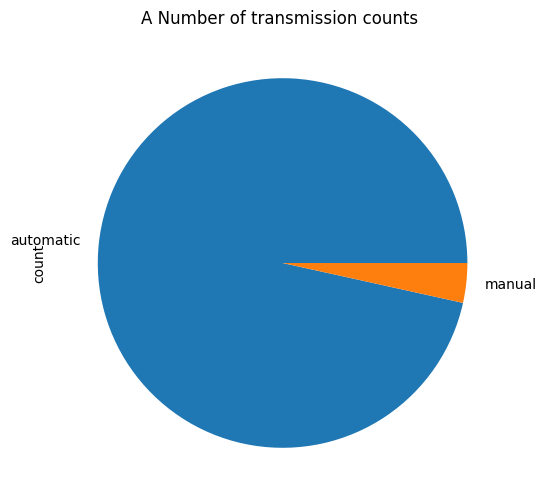

In [144]:
plt.figure(figsize=(8, 6))
transmission_counts.plot(kind='pie')
plt.title('A Number of transmission counts ')
plt.show()

In [145]:
STATE = df['state'].value_counts()

In [146]:
STATE

state
fl    75243
ca    66213
tx    41657
ga    30939
pa    24117
nj    23003
il    21494
oh    20294
tn    19183
nc    18731
mo    15286
mi    14185
nv    11682
md     9788
va     9448
wi     9196
mn     8627
az     7612
wa     7012
co     6270
ma     6167
ny     4749
in     3879
sc     3754
ne     3685
pr     2427
la     1744
ms     1730
ut     1716
hi     1205
or     1047
nm      163
ok       54
al       25
Name: count, dtype: int64

In [147]:
ST = pd.crosstab(df["state"],df["transmission"])

In [148]:
px.line(ST,title= "Distribution of ST all cars")

In [149]:
SM = pd.crosstab(df["state"],df["make"]).sum()

In [150]:
px.bar(SM,title= "Distribution of SM all cars")

In [151]:
SB = pd.crosstab(df["state"],df["body"])

In [152]:
px.line(SB,title= "Distribution of SB all cars")

In [153]:
SY = pd.crosstab(df["state"],df["year"]).sum()

In [154]:
px.bar(SY,title= "Distribution of SY all cars")

In [155]:
df.columns.to_list()

['year',
 'make',
 'model',
 'trim',
 'body',
 'transmission',
 'state',
 'condition',
 'odometer',
 'color',
 'interior',
 'seller',
 'mmr',
 'sellingprice',
 'saledate']

In [156]:
Condition= df['condition'].value_counts()

In [157]:
px.bar(Condition,title= "Distribution of SY all cars")

In [158]:
CY = pd.crosstab(df["condition"],df["year"]).sum()

In [159]:
px.line(CY,title= "Distribution of CY all cars")

In [160]:
# Cria um gráfico de pizza
fig = go.Figure(data=[go.Pie(labels=df["year"], values=df["condition"])])
# Define o título
fig.update_layout(title_text='Gráfico de Pizza Exemplo')

# Exibir o gráfico
fig.show()

In [161]:
px.bar(CY,title= "Distribuição de SY de todos os carros")

In [162]:
CMM = pd.crosstab(df["condition"],df["make"])

In [163]:
px.line(CMM,title= "Distribuição de CMM de todos os carros")

In [164]:
px.bar(CMM,title= "Distribuição de CMM de todos os carros")

In [165]:
CM = pd.crosstab(df["condition"],df["model"]).sum()

In [166]:
px.line(CM,title= "Distribuição de CM de todos os carros")

In [167]:
CT = pd.crosstab(df["condition"],df["transmission"])

In [168]:
px.line(CT,title= "Distribuição de CT de todos os carros")

In [169]:
CS = pd.crosstab(df["condition"],df["state"])

In [170]:
CS

state,al,az,ca,co,fl,ga,hi,il,in,la,...,or,pa,pr,sc,tn,tx,ut,va,wa,wi
condition,,,,,,,,,,,,,,,,,,,,,
1.0,1,101,1294,24,433,138,4,133,110,71,...,33,153,29,126,119,439,141,252,76,312
2.0,0,261,2851,126,2538,1184,25,680,263,62,...,100,747,91,164,337,1411,119,625,301,399
3.0,0,131,1472,212,1554,353,43,1127,81,30,...,20,811,77,134,144,674,29,158,125,108
4.0,0,197,1756,295,4325,616,45,2082,66,38,...,28,1483,52,114,481,988,16,347,165,167
5.0,0,43,837,177,1386,553,15,622,47,18,...,12,427,2,52,786,692,2,165,185,180
11.0,0,0,14,1,8,5,1,2,0,1,...,0,3,0,0,2,18,1,2,2,3
12.0,0,0,19,2,7,5,0,2,1,1,...,1,2,0,0,4,14,1,1,2,5
13.0,0,2,8,0,10,3,0,3,1,1,...,1,3,0,0,0,18,0,3,0,2
14.0,0,1,15,1,20,5,1,6,0,1,...,0,6,1,0,6,20,0,1,1,3


In [171]:
px.bar(CS,title= "Distribuição de Cs de todos os carros")

In [172]:
df.columns.to_list()

['year',
 'make',
 'model',
 'trim',
 'body',
 'transmission',
 'state',
 'condition',
 'odometer',
 'color',
 'interior',
 'seller',
 'mmr',
 'sellingprice',
 'saledate']

In [173]:
Odometer = df['odometer'].value_counts()

In [174]:
CS = pd.crosstab(df["condition"],df["odometer"]).sum()

In [175]:
CS

odometer
1.0         979
2.0          10
3.0           5
4.0           7
5.0          13
           ... 
621388.0      1
694978.0      2
959276.0      1
980113.0      1
999999.0     60
Length: 160427, dtype: int64

In [176]:
px.line(CS,title= "Distribuição de CS de todos os carros")

In [177]:
COLOR = df['color'].value_counts()

In [178]:
COLOR

color
black        93244
white        89233
silver       71251
gray         70640
blue         43060
red          37336
—            22068
gold          9563
green         9234
burgundy      7605
beige         7444
brown         5621
orange        1763
purple        1270
off-white     1244
yellow        1079
charcoal       429
turquoise      190
pink            39
lime            12
Name: count, dtype: int64

In [179]:
px.bar(COLOR,title= "Distribuição de Cor Exterior de todos os carros")

In [180]:
MC = pd.crosstab(df['make'],df["color"])

In [181]:
MC

color,beige,black,blue,brown,burgundy,charcoal,gold,gray,green,lime,off-white,orange,pink,purple,red,silver,turquoise,white,yellow,—
make,,,,,,,,,,,,,,,,,,,,
Acura,33,1253,281,15,106,4,94,967,72,0,28,2,0,8,148,726,2,711,0,53
Aston Martin,0,11,2,0,0,1,0,5,1,0,0,0,0,0,0,2,0,1,0,1
Audi,36,1490,445,35,2,4,36,742,23,0,2,0,0,4,143,703,1,915,3,218
BMW,152,5423,1734,211,55,6,134,3380,205,0,3,13,1,10,506,1825,5,3389,1,456
Bentley,0,32,22,2,0,1,0,19,2,0,0,0,0,0,2,13,0,10,0,2
Buick,270,546,292,196,122,3,286,493,79,0,39,0,0,22,256,887,2,910,0,67
Cadillac,306,1951,372,89,82,9,306,482,66,0,141,0,14,27,356,912,3,1135,0,64
Chevrolet,1479,8977,4865,579,810,66,1506,6819,696,1,52,264,12,138,4832,9774,22,12073,278,907
Chrysler,301,2649,1971,104,315,31,581,1995,200,0,92,7,0,49,1390,2511,11,2630,8,288


In [182]:
px.bar(MC,title= "Distribuição de Cor Exterior de todos os carros")

In [183]:
Interior = df['interior'].value_counts()

In [184]:
Interior

interior
black        209865
gray         152616
beige         50469
tan           37723
—              9864
brown          7102
red            1128
silver         1002
blue            917
off-white       355
gold            288
purple          287
white           212
green           200
burgundy        154
orange          124
yellow           19
Name: count, dtype: int64

In [185]:
px.bar(Interior,title= "Distribuição de Cor Interior de todos os carros")

In [186]:
Seller = df['seller'].value_counts()

In [187]:
Seller

seller
ford motor credit company llc      17756
the hertz corporation              16286
nissan-infiniti lt                 15777
santander consumer                 14245
avis corporation                   11471
                                   ...  
nu image auto llc                      1
derek scott's auto park                1
maserati north america inc             1
alternative financial group inc        1
lienemann auto sales inc               1
Name: count, Length: 11923, dtype: int64

In [188]:
Seller = Seller[Seller > 1000]
Seller

seller
ford motor credit company llc       17756
the hertz corporation               16286
nissan-infiniti lt                  15777
santander consumer                  14245
avis corporation                    11471
                                    ...  
td auto finance                      1137
kevins marysville auto sales inc     1099
ars/enterprise                       1084
oriental bank                        1044
pv holding inc/gdp                   1032
Name: count, Length: 62, dtype: int64

In [189]:
px.line(Seller,title= "Distribuição das entidades vendedoras dos veículos (todos os carros)")

In [190]:
SMM = pd.crosstab(df['seller'],df["make"]).sum()

In [191]:
SMM

make
Acura             4503
Aston Martin        24
Audi              4802
BMW              17509
Bentley            105
Buick             4470
Cadillac          6315
Chevrolet        54150
Chrysler         15133
Daewoo               2
Dodge            27181
FIAT               725
Ferrari             17
Fisker               9
Ford             81013
GMC               9217
Geo                 16
HUMMER             768
Honda            24781
Hyundai          18659
Infiniti         14011
Isuzu              179
Jaguar            1257
Jeep             12735
Kia              15828
Lamborghini          3
Land Rover        1322
Lexus            10409
Lincoln           4926
Lotus                1
MINI              2946
Maserati           109
Mazda             6930
Mercedes-Benz    14008
Mercury           1571
Mitsubishi        3661
Nissan           44043
Oldsmobile         318
Plymouth            16
Pontiac           4018
Porsche           1157
Ram               4044
Rolls-Royce         16
Saab  

In [192]:
px.bar(SMM,title= "Distribuição das entidades responsáveis pela venda dos veículos em todos os carros")

In [193]:
df.columns.to_list()

['year',
 'make',
 'model',
 'trim',
 'body',
 'transmission',
 'state',
 'condition',
 'odometer',
 'color',
 'interior',
 'seller',
 'mmr',
 'sellingprice',
 'saledate']

In [194]:
df['profit_or_loss'] = df['mmr'] - df['sellingprice']

In [195]:
df['profit_or_loss'].describe()

count    472325.000000
mean        146.546905
std        1741.175011
min     -207200.000000
25%        -650.000000
50%          50.000000
75%         800.000000
max       87750.000000
Name: profit_or_loss, dtype: float64

In [196]:
PL = df['profit_or_loss'].value_counts()

In [197]:
px.line(PL,title= "Distribuição dos lucros ou prejuízos de todos os carros")